# Interactive Full Label and Trajectory Visualization

In [3]:
import os
import sys
sys.path.append(os.path.abspath('../..'))
# from tabluence.data.api.smartwatch.utilities.preparations import *
import pandas
import plotly_express as px
import numpy
import json
import pickle
import gzip
import matplotlib.pyplot as plt
from copy import deepcopy
from functools import reduce
from tqdm import tqdm
from datetime import datetime, timezone
from typing import Dict, List, Tuple, Union, Any, Iterator
import torch.utils.data.dataloader
from tabluence.data.api.smartwatch.utilities.timestamp import get_utc_date_from_utc_timestamp
from tabluence.data.api.smartwatch.data_manager.module import SmartwatchDataManager
from tabluence.deep_learning.data.dataset.smartwatch_study.single_slice import get_dataloaders, SmartwatchStudySingleSliceDataset, single_slice_collate_fn
from tabluence.deep_learning.data.pipeline.fusion.single_slice import SliceToSliceFusion
from typing import List, Dict, Any
import torch
import torch.utils.data.dataloader
from tabluence.data.api.smartwatch.data_manager import SmartwatchDataManager
from tabluence.deep_learning.data.dataset.smartwatch_study.single_slice import SmartwatchStudySingleSliceDataset, \
    BalancedStressLevelSampler, single_slice_collate_fn
from tabluence.data.api.smartwatch.utilities.timestamp import *
from plotly.subplots import make_subplots

def change_df(df, value_column):
    df = df.copy()
    df['utc_date'] = df['utc_timestamp'].apply(lambda x: get_utc_date_from_utc_timestamp(x))
    df = df.loc[:, ['utc_timestamp', 'utc_date', value_column]]
    df.rename({value_column: 'value'}, inplace=True, axis=1, errors='raise')
    df['signal'] = value_column[:-len('_tsvalue')]
    return df

import logging
logging.basicConfig(format='%(asctime)s - %(name)s - %(levelname)s - %(message)s', level=logging.DEBUG)
logger = logging.getLogger(__name__)
logger.setLevel(logging.DEBUG)

In [4]:
data_manager = SmartwatchDataManager(
        root_dir='../../resources/warrior_wellness/Analysis/local_repo/',
        subject_id_list=[f'SWS_{i:02d}' for i in range(0,15)],
        cache_filepath='cache.pkl.gz'
    )

In [74]:
for subject_id in tqdm([f'SWS_{e:02d}' for e in range(1, 15) if e != 10]):
    signals = data_manager.get_subject_signals_for_utc_timestamp_range(subject_id, data_manager.get_utc_timestamp_range_for_subject(subject_id))
    subject_overall_stress_function = data_manager.get_subject_general_stress_function(subject_id=subject_id)
    subject_specific_stress_function = data_manager.get_subject_specific_stress_function(subject_id=subject_id, stress_types=["induced", "general", "interpersonal"])
    df = pandas.concat([
        change_df(signals['daily'], 'heart_rate_tsvalue'),
        change_df(signals['respiration'], 'epoch_to_breath_tsvalue'),
        change_df(signals['stress'], 'stress_level_tsvalue'),
        change_df(signals['pulseOx'], 'spo2_tsvalue'),

    ])
    
    t_start, t_end = data_manager.get_utc_timestamp_range_for_subject(subject_id)

    utc_timestamp_vals = numpy.linspace(t_start, t_end, 10000)
    utc_date_vals = [get_utc_date_from_utc_timestamp(x) for x in numpy.linspace(t_start, t_end, 10000).tolist()]
    specific_stress_vals = subject_specific_stress_function(utc_timestamp_vals)
    overall_stress_vals = subject_overall_stress_function(utc_timestamp_vals)

    df = pandas.concat([
        df,
        pandas.DataFrame({
            'utc_timestamp': utc_timestamp_vals,
            'utc_date': utc_date_vals,
            'value': overall_stress_vals,
            'signal': 'overall_stress'}),
        pandas.DataFrame({
            'utc_timestamp': utc_timestamp_vals,
            'utc_date': utc_date_vals,
            'value': specific_stress_vals['general'],
            'signal': 'specific_stress: <general>'}),
        pandas.DataFrame({
            'utc_timestamp': utc_timestamp_vals,
            'utc_date': utc_date_vals,
            'value': specific_stress_vals['induced'],
            'signal': 'specific_stress: <induced>'}),
        pandas.DataFrame({
            'utc_timestamp': utc_timestamp_vals,
            'utc_date': utc_date_vals,
            'value': specific_stress_vals['interpersonal'],
            'signal': 'specific_stress: <interpersonal>'}),
    ])
    
    fig = px.line(df, x='utc_date', hover_data=['utc_date', 'utc_timestamp'], color='signal', y='value', title=subject_id)
    fig.write_html(f'interactive_signals/{subject_id}.html')

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 13/13 [00:42<00:00,  3.26s/it]


In [ ]:
! tar czvf interactive_smartwatch_journeys.tar.gz interactive_signals

interactive_signals/
interactive_signals/SWS_06.html


In [72]:
len(utc_date_vals)

10000

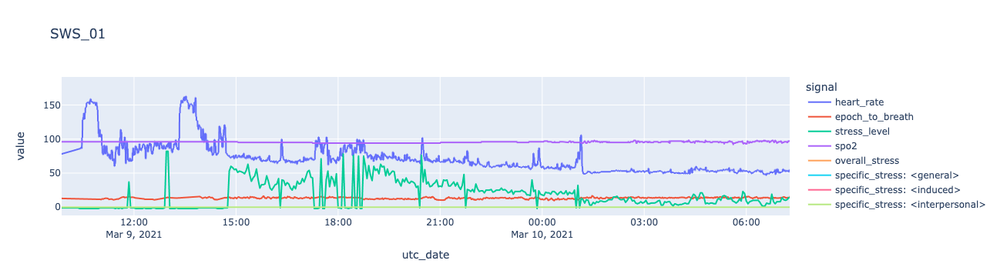

In [64]:
fig = px.line(df, x='utc_date', hover_data=['utc_date', 'utc_timestamp'], color='signal', y='value', title=subject_id)
fig.show()

In [65]:
fig.write_html(f'interactive_signals/{subject_id}.html')

In [38]:
from tabluence.data.api.smartwatch.secured_meta.stress_labels import stress_labels  

In [45]:
t_start, t_end = data_manager.get_utc_timestamp_range_for_subject(subject_id)


df = pandas.concat([
    df,
    pandas.DataFrame({
        'utc_timestamp': numpy.linspace(t_start, t_end, 10000),
        'utc_date': [get_utc_date_from_utc_timestamp(x) for x in numpy.linspace(t_start, t_end, 10000).tolist()],
        'value': subject_overall_stress_function(numpy.linspace(t_start, t_end, 10000)),
        'signal': 'overall_stress'})])

In [47]:
utc_timestamp_vals = numpy.linspace(t_start, t_end, 10000)

subject_specific_stress_function(utc_timestamp_vals)

{'general': array([0., 0., 0., ..., 0., 0., 0.]),
 'interpersonal': array([0., 0., 0., ..., 0., 0., 0.]),
 'induced': array([0., 0., 0., ..., 0., 0., 0.])}

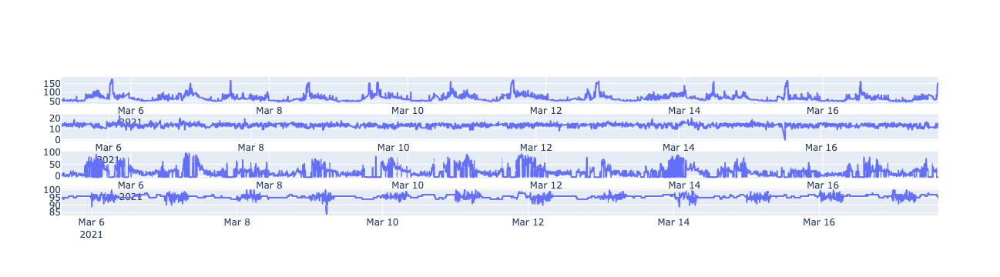

In [34]:
fig1 = px.line(signals['daily'], x='utc_date', y='heart_rate_tsvalue', hover_data=['utc_date'])
fig2 = px.line(signals['respiration'], x='utc_date', y='epoch_to_breath_tsvalue', hover_data=['utc_date'])
fig3 = px.line(signals['stress'], x='utc_date', y='stress_level_tsvalue', hover_data=['utc_date'])
fig4 = px.line(signals['pulseOx'], x='utc_date', y='spo2_tsvalue', hover_data=['utc_date'])

fig = make_subplots(rows=4, cols=1, shared_xaxes=False)
fig.add_trace(fig1['data'][0], row=1, col=1)
fig.add_trace(fig2['data'][0], row=2, col=1)
fig.add_trace(fig3['data'][0], row=3, col=1)
fig.add_trace(fig4['data'][0], row=4, col=1)
fig.show()